# Example of GLM applied to fMRI data preprocessed with `fmriprep`

In [10]:
import os
import numpy as np
import pandas as pd

In [11]:
import matplotlib.pyplot as plt
from IPython.display import IFrame, Image

In [12]:
%matplotlib inline

## Exploring `fmriprep` output within BIDS data 

In [13]:
!ls ds000105/derivatives

dataset_description.json  mriqc       sub-2	  sub-4       sub-6
desc-aparcaseg_dseg.tsv   sourcedata  sub-2.html  sub-4.html  sub-6.html
desc-aseg_dseg.tsv	  sub-1       sub-3	  sub-5
logs			  sub-1.html  sub-3.html  sub-5.html


### Let's first look at the file hierarchy

In [14]:
!tree -L 4 ds000105

ds000105
├── CHANGES
├── README
├── dataset_description.json
├── derivatives
│   ├── dataset_description.json
│   ├── desc-aparcaseg_dseg.tsv
│   ├── desc-aseg_dseg.tsv
│   ├── logs
│   │   ├── CITATION.bib
│   │   ├── CITATION.md
│   │   └── CITATION.tex
│   ├── mriqc
│   │   ├── anatMRIQC.csv
│   │   ├── anatomical_group.pdf
│   │   ├── anatomical_sub-1.pdf
│   │   ├── anatomical_sub-2.pdf
│   │   ├── anatomical_sub-3.pdf
│   │   ├── anatomical_sub-4.pdf
│   │   ├── anatomical_sub-5.pdf
│   │   ├── anatomical_sub-6.pdf
│   │   ├── funcMRIQC.csv
│   │   ├── functional_group.pdf
│   │   ├── functional_sub-1.pdf
│   │   ├── functional_sub-2.pdf
│   │   ├── functional_sub-3.pdf
│   │   ├── functional_sub-4.pdf
│   │   ├── functional_sub-5.pdf
│   │   └── functional_sub-6.pdf
│   ├── sourcedata
│   │   └── freesurfer
│   │       ├── fsaverage
│   │       ├── sub-1
│   │       ├── sub-2
│   │       ├── sub-3
│   │       ├── sub-4
│   │       ├── sub-5
│   │       └── sub-6
│   ├── sub-1
│ 

│   └── func
│       ├── sub-4_task-objectviewing_run-01_bold.nii.gz
│       ├── sub-4_task-objectviewing_run-01_events.tsv
│       ├── sub-4_task-objectviewing_run-02_bold.nii.gz
│       ├── sub-4_task-objectviewing_run-02_events.tsv
│       ├── sub-4_task-objectviewing_run-03_bold.nii.gz
│       ├── sub-4_task-objectviewing_run-03_events.tsv
│       ├── sub-4_task-objectviewing_run-04_bold.nii.gz
│       ├── sub-4_task-objectviewing_run-04_events.tsv
│       ├── sub-4_task-objectviewing_run-05_bold.nii.gz
│       └── sub-4_task-objectviewing_run-05_events.tsv
├── sub-5
│   ├── anat
│   │   └── sub-5_T1w.nii.gz
│   └── func
│       ├── sub-5_task-objectviewing_run-01_bold.nii.gz
│       ├── sub-5_task-objectviewing_run-01_events.tsv
│       ├── sub-5_task-objectviewing_run-02_bold.nii.gz
│       ├── sub-5_task-objectviewing_run-02_events.tsv
│       ├── sub-5_task-objectviewing_run-03_bold.nii.gz
│       ├── sub-5_task-objectviewing_run-03_events.tsv
│       ├── sub-5_task-objectviewi

### Now let's have a look at the fmriprep report

In [15]:
fmriprep_dir = os.path.join('ds000105', 'derivatives')

In [16]:
IFrame(src=os.path.join(fmriprep_dir, 'sub-1.html'), width=900, height=600)

As mentioned in the BIDS lecture, the python package `pybids` offers convenient functions to parse a BIDS dataset. At the heart of this package is a `BIDSLayout` object which offers a representation of the the whole dataset, and can be queried in many different ways. 

### Let's use the power of BIDS to explore the output

In [17]:
from bids import BIDSLayout
import os

data_dir = 'ds000105'
bids_layout = BIDSLayout(data_dir, derivatives=True)
bids_layout

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/bids/layout/models.py:148: FutureWarning: The 'extension' entity currently excludes the leading dot ('.'). As of version 0.14.0, it will include the leading dot. To suppress this warning and include the leading dot, use `bids.config.set_option('extension_initial_dot', True)`.
  warnings.warn("The 'extension' entity currently excludes the leading dot ('.'). "


BIDS Layout: .../home/brainhacker/glm/ds000105 | Subjects: 6 | Sessions: 0 | Runs: 30

In [18]:
bids_layout.get_subjects()

['1', '2', '3', '4', '5', '6']

In [19]:
bids_layout.get_tasks()

['objectviewing']

In [20]:
bids_layout.get_runs(subject="1")

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

### Examining nuisance regressors

In [21]:
sub1_run1_confounds_file = bids_layout.get(scope='fMRIPrep', desc='confounds', extension='tsv', 
                                           subject=1, run=1)[0]
sub1_run1_confounds_file

<BIDSDataFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/func/sub-1_task-objectviewing_run-1_desc-confounds_timeseries.tsv'>

In [22]:
sub1_run1_confounds_df = sub1_run1_confounds_file.get_df()
sub1_run1_confounds_df

,global_signal,global_signal_derivative1,global_signal_derivative1_power2,global_signal_power2,csf,csf_derivative1,csf_derivative1_power2,csf_power2,white_matter,white_matter_derivative1,...,rot_y_power2,rot_y_derivative1_power2,rot_z,rot_z_derivative1,rot_z_derivative1_power2,rot_z_power2,motion_outlier00,motion_outlier01,motion_outlier02,motion_outlier03
0,1457.208517,NaN,NaN,2.123457e+06,2161.063703,NaN,NaN,4.670196e+06,1777.534950,NaN,...,1.544950e-06,NaN,-0.001048,NaN,NaN,1.099080e-06,0.0,0.0,0.0,0.0
1,1455.122097,-2.086420,4.353149,2.117380e+06,2157.891166,-3.172537,10.064989,4.656494e+06,1777.075782,-0.459168,...,6.296788e-07,2.019936e-07,-0.001273,-0.000225,5.047212e-08,1.620605e-06,0.0,0.0,0.0,0.0
2,1454.048395,-1.073702,1.152836,2.114257e+06,2156.487656,-1.403510,1.969841,4.650439e+06,1775.334909,-1.740873,...,4.340636e-09,7.385795e-07,0.000076,0.001349,1.820327e-06,5.801107e-09,0.0,0.0,0.0,0.0
3,1454.180952,0.132557,0.017571,2.114642e+06,2156.906568,0.418912,0.175487,4.652246e+06,1777.045735,1.710826,...,9.175456e-07,7.956685e-07,0.001716,0.001640,2.689780e-06,2.945411e-06,0.0,0.0,0.0,0.0
4,1455.379270,1.198318,1.435965,2.118129e+06,2157.126084,0.219516,0.048187,4.653193e+06,1777.185424,0.139690,...,4.519913e-11,9.047110e-07,0.000832,-0.000884,7.816664e-07,6.923921e-07,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,1453.081352,-1.563445,2.444360,2.111445e+06,2155.078987,-0.545824,0.297924,4.644365e+06,1770.625236,0.251529,...,1.097577e-05,8.331882e-08,0.003221,0.000592,3.504166e-07,1.037458e-05,0.0,0.0,0.0,0.0
117,1453.541346,0.459993,0.211594,2.112782e+06,2156.236154,1.157167,1.339036,4.649354e+06,1773.334158,2.708922,...,1.119833e-05,1.116896e-09,0.002884,-0.000337,1.135623e-07,8.317283e-06,0.0,0.0,0.0,0.0
118,1450.314261,-3.227084,10.414073,2.103411e+06,2154.146495,-2.089659,4.366676,4.640347e+06,1771.550054,-1.784104,...,5.565683e-06,9.746033e-07,0.002704,-0.000180,3.222384e-08,7.314104e-06,0.0,0.0,0.0,0.0
119,1450.878401,0.564140,0.318253,2.105048e+06,2151.667072,-2.479423,6.147538,4.629671e+06,1771.688590,0.138536,...,8.198659e-06,2.541773e-07,0.002651,-0.000054,2.893364e-09,7.026051e-06,0.0,0.0,0.0,0.0


In [23]:
sub1_run1_confounds_df.columns.values

array(['global_signal', 'global_signal_derivative1',
       'global_signal_derivative1_power2', 'global_signal_power2', 'csf',
       'csf_derivative1', 'csf_derivative1_power2', 'csf_power2',
       'white_matter', 'white_matter_derivative1',
       'white_matter_derivative1_power2', 'white_matter_power2', 'csf_wm',
       'tcompcor', 'std_dvars', 'dvars', 'framewise_displacement', 'rmsd',
       't_comp_cor_00', 't_comp_cor_01', 't_comp_cor_02', 'a_comp_cor_00',
       'a_comp_cor_01', 'a_comp_cor_02', 'a_comp_cor_03', 'a_comp_cor_04',
       'a_comp_cor_05', 'a_comp_cor_06', 'a_comp_cor_07', 'a_comp_cor_08',
       'a_comp_cor_09', 'a_comp_cor_10', 'a_comp_cor_11', 'a_comp_cor_12',
       'a_comp_cor_13', 'a_comp_cor_14', 'a_comp_cor_15', 'a_comp_cor_16',
       'a_comp_cor_17', 'a_comp_cor_18', 'a_comp_cor_19', 'a_comp_cor_20',
       'a_comp_cor_21', 'a_comp_cor_22', 'a_comp_cor_23', 'a_comp_cor_24',
       'a_comp_cor_25', 'a_comp_cor_26', 'a_comp_cor_27', 'a_comp_cor_28',
      

### Notable metrics computed by fmriprep to detect outliers
* DVARS is the rate of change of the BOLD signal across the entire brain:
$$\text{DVARS}_t = \sqrt{\frac{1}{N}\sum_i \left[x_{i,t} - x_{i,t-1}\right]^2}$$
* FD is the Framewise Displacement: it quantifies head motion.
$$\text{FD}_t = |\Delta d_{x,t}| + |\Delta d_{y,t}| + |\Delta d_{z,t}| + |\Delta \alpha_t| + |\Delta \beta_t| + |\Delta \gamma_t|$$

Rotational displacements are calculated as the displacement on the surface of a sphere of radius 50 mm [Power2012].

In `fmriprep` spike outliers are identified by default with FD > 0.5 mm or DVARS > 1.5

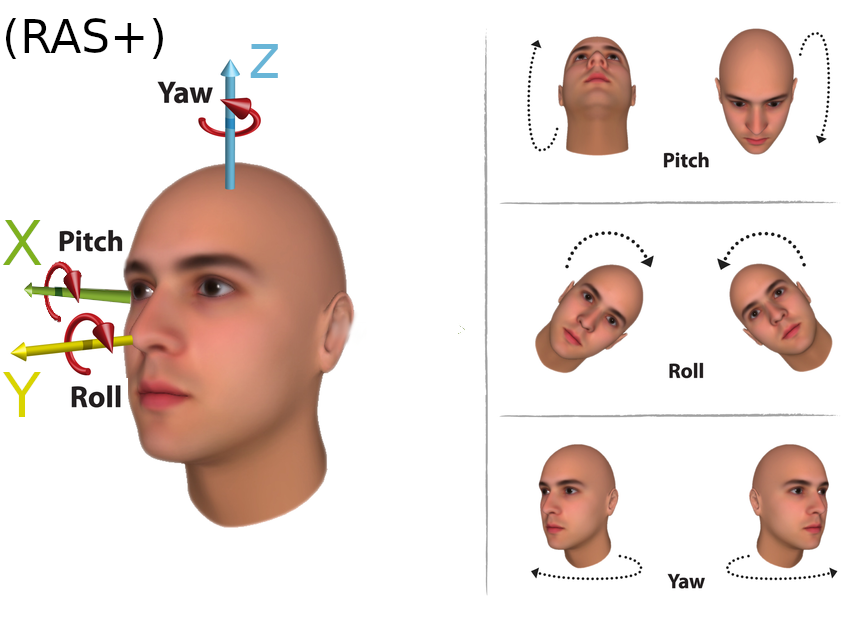

In [44]:
Image(filename="rot_angles_mod2.png", width=500)

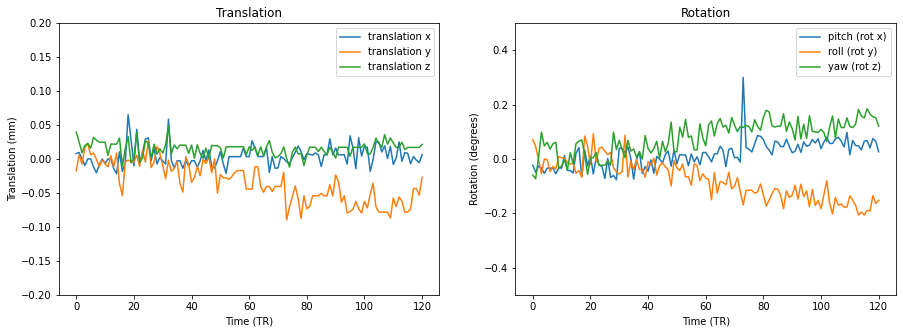

In [55]:
fig, axes = plt.subplots(ncols=2, figsize=(15,5))

sub1_run1_confounds_df.loc[:,['trans_x','trans_y','trans_z']].plot(ax=axes[0])
axes[0].set_ylim((-0.2, 0.2))
axes[0].set_ylabel('Translation (mm)')
axes[0].set_xlabel('Time (TR)')
axes[0].set_title('Translation');
axes[0].legend(['translation x','translation y','translation z']);

sub1_run1_confounds_df.loc[:,['rot_x','rot_y','rot_z']].mul(360/(2*np.pi)).plot(ax=axes[1])
axes[1].set_ylim((-0.5, 0.5))
axes[1].legend(['pitch (rot x)','roll (rot y)','yaw (rot z)']);
axes[1].set_ylabel('Rotation (degrees)')
axes[1].set_xlabel('Time (TR)')
axes[1].set_title('Rotation');

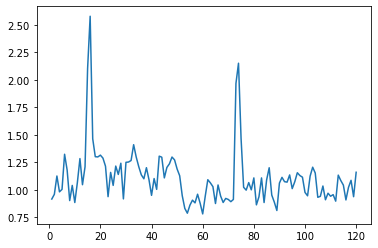

In [54]:
sub1_run1_confounds_df['std_dvars'].plot()

In [24]:
sub1_run1_confounds_df['std_dvars'].loc[sub1_run1_confounds_df['std_dvars']>1.5]

15    2.102444
16    2.577286
73    1.966802
74    2.150434
Name: std_dvars, dtype: float64

### Exercise
Find volumes with `std_dvars` greater than `1.5`

### Visualization (with nilearn)

In [25]:
from nilearn import plotting

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/datasets/__init__.py:87: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  warn("Fetchers from the nilearn.datasets module will be "


In [26]:
sub1_anat_files = bids_layout.get(subject="1", scope="derivatives", datatype='anat')
sub1_anat_files

[<BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-aparcaseg_dseg.nii.gz'>,
 <BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-aseg_dseg.nii.gz'>,
 <BIDSJSONFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-brain_mask.json'>,
 <BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-brain_mask.nii.gz'>,
 <BIDSJSONFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-preproc_T1w.json'>,
 <BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-preproc_T1w.nii.gz'>,
 <BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_dseg.nii.gz'>,
 <BIDSFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_from-fsnative_to-T1w_mode-image_xfm.txt'>,
 <BIDSFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_from-MNI152NLin2009cAsy

In [27]:
bids_layout.get(subject="1", scope="derivatives", datatype='anat', suffix='dseg',
                extension='nii.gz', return_type='filename')

['/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-aparcaseg_dseg.nii.gz',
 '/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_desc-aseg_dseg.nii.gz',
 '/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_dseg.nii.gz',
 '/home/brainhacker/glm/ds000105/derivatives/sub-1/anat/sub-1_space-MNI152NLin2009cAsym_dseg.nii.gz']

In [28]:
seg_file = bids_layout.get(subject="1", scope="derivatives", datatype='anat', suffix='dseg',
                           extension='nii.gz', return_type='filename')[2]
t1_file = bids_layout.get(subject="1", scope="derivatives", datatype='anat', desc='preproc',
                            extension='nii.gz', return_type='filename')[0]
t1_mni_file = bids_layout.get(subject="1", scope="derivatives", datatype='anat', desc='preproc',
                              space='MNI152NLin2009cAsym', extension='nii.gz', return_type='filename')[0]
t1_mask_file = bids_layout.get(subject="1", scope="derivatives", datatype='anat', suffix='mask',
                               desc='brain', extension='nii.gz', return_type='filename')[0]

#### Visualization

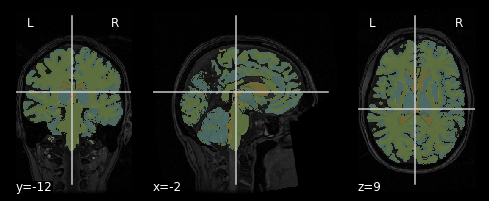

In [30]:
display = plotting.plot_roi(roi_img=seg_file, bg_img=t1_file, alpha=0.4, cmap="Set3");

In [31]:
display.close()


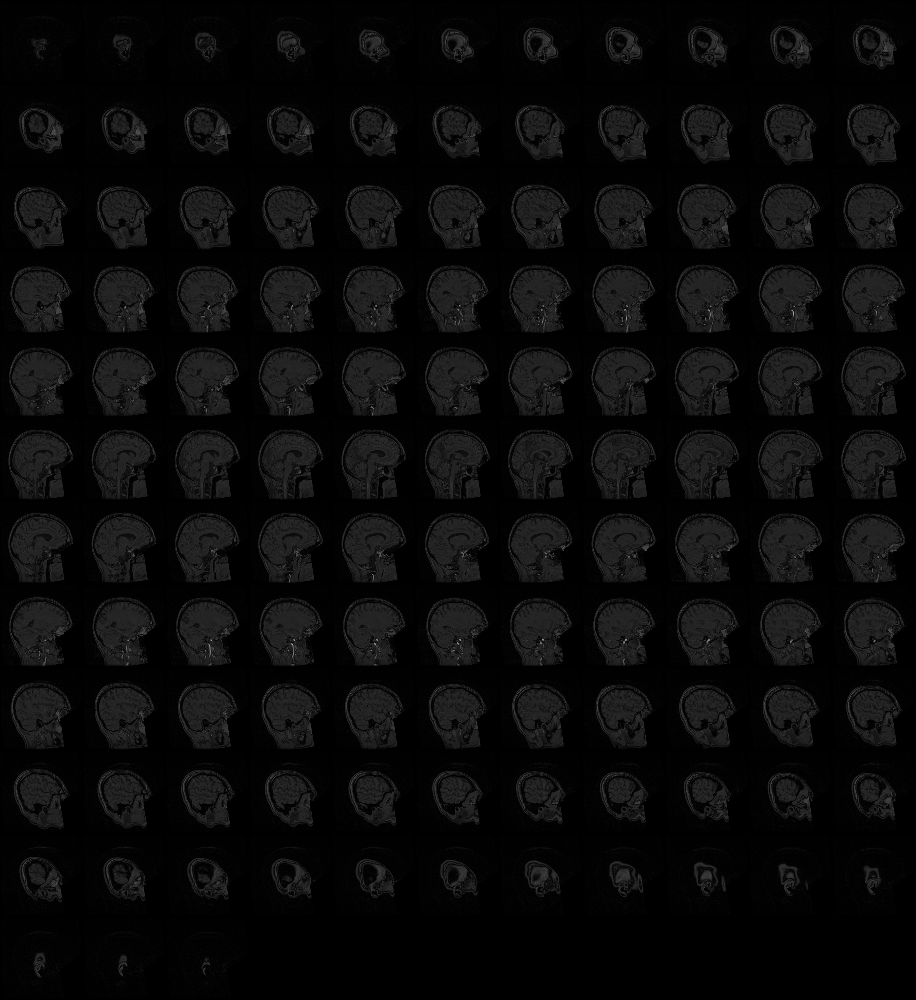
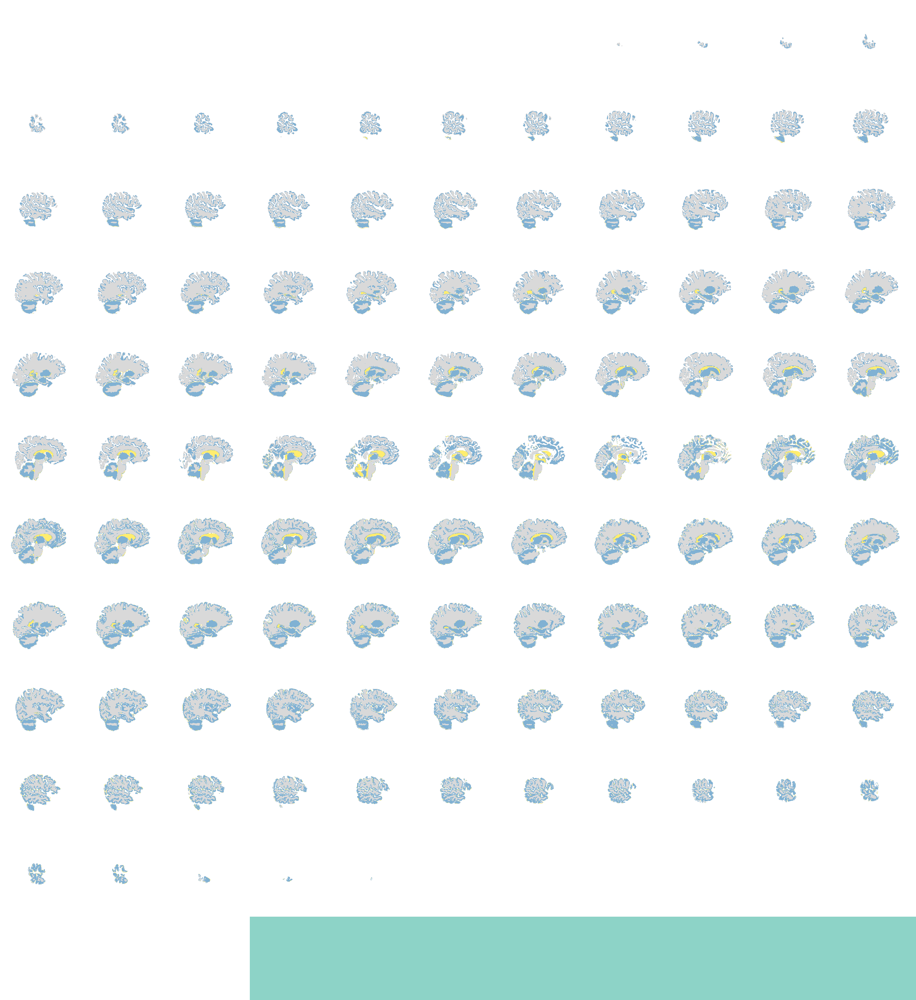

In [32]:
plotting.view_img(stat_map_img=seg_file, bg_img=t1_file, cmap="Set3", 
                  symmetric_cmap=False, opacity=0.4)

In [33]:
mask_labels = {"Gray Matter": 1, "White Matter": 2, "Cerebrospinal Fluid": 3}

**Exercise**
1. Find two images with `pybids`:
  * the functional data in the MNI template space (for the run 1 of subject 1), and save its path as `sub1_func_mni_file`
  * the anatomical tissue segmented data in the MNI template space (for subject 1), and save its path as `sub1_dseg_mni_file`
2. Use the `plotting.plot_carpet` function of the `nilearn` `plotting` module with the two images above and the `mask_labels` dictionary to get a summary plot of the func data of run 1 for subject 1. Use the same colormap `Set3` as before for consistency.
  * *hint 1*: use `plotting.plot_carpet?` for help
  * *hint 2*: use `bids_layout.get(subject="1", scope="derivatives", datatype='func', run='1', extension='nii.gz')` to get a list of potential candidates for the functional data
  * *hint 3*: the func data has `space` `MNI152NLin2009cAsym` and `suffix` `bold`
  * *hint 4*: the dseg data has `space` `MNI152NLin2009cAsym` and `suffix` `dseg`

#### Visualization (with nibabel)

In [34]:
# Note: since a list is always returned, we use [0] to get the first (and only) element
func_file = bids_layout.get(scope="derivatives", subject="1", run="1", extension='nii.gz', 
                            suffix="bold")[0]
func_file

<BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/func/sub-1_task-objectviewing_run-1_space-MNI152NLin2009cAsym_desc-preproc_bold.nii.gz'>

In [35]:
# Note: since a list is always returned, we use [0] to get the first (and only) element
func_mask_file = bids_layout.get(scope="derivatives", subject="1", run="1", extension='nii.gz', 
                                 datatype='func', suffix="mask")[0]
func_mask_file

<BIDSImageFile filename='/home/brainhacker/glm/ds000105/derivatives/sub-1/func/sub-1_task-objectviewing_run-1_space-MNI152NLin2009cAsym_desc-brain_mask.nii.gz'>

In [36]:
import nibabel as nib

In [37]:
# Functional data
func = nib.load(func_file)
func_data = func.get_fdata()
# Functional data mask
func_mask = nib.load(func_mask_file)
func_mask_data = func_mask.get_fdata()

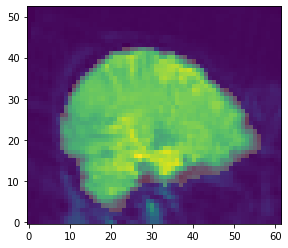

In [348]:
plt.imshow(func_data[20, :, :, 70].T, origin="lower");
plt.imshow(func_mask_data[20, :, :].T, origin="lower", alpha=0.2);

In [303]:
plt.imshow?

In [38]:
# Let's pick a voxel and look at its time series (ts)
my_voxel_ts = func_data[20, 15, 30, :]

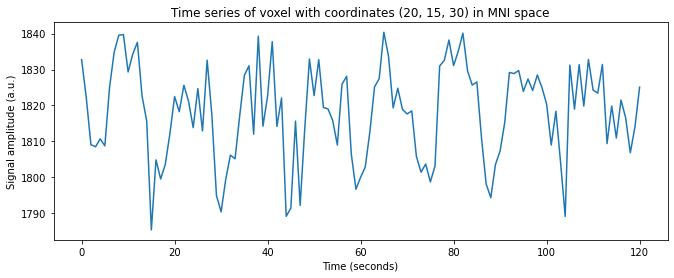

In [39]:
plt.figure(figsize=(11, 4))
plt.plot(my_voxel_ts)
plt.xlabel('Time (seconds)')
plt.ylabel('Signal amplitude (a.u.)')
plt.title('Time series of voxel with coordinates (20, 15, 30) in MNI space');

### Stimuli

In [40]:
event_files = bids_layout.get(subject="1", task="objectviewing", suffix="events")
event_files

[<BIDSDataFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-01_events.tsv'>,
 <BIDSDataFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-02_events.tsv'>,
 <BIDSDataFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-03_events.tsv'>,
 <BIDSDataFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-04_events.tsv'>,
 <BIDSDataFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-05_events.tsv'>]

In [41]:
run1_events_df = event_files[0].get_df()
run1_events_df

,onset,duration,trial_type
0,12.0,0.5,scissors
1,14.0,0.5,scissors
2,16.0,0.5,scissors
3,18.0,0.5,scissors
4,20.0,0.5,scissors
...,...,...,...
91,278.0,0.5,chair
92,280.0,0.5,chair
93,282.0,0.5,chair
94,284.0,0.5,chair


#### Sanity check

In [43]:
# Checking that no other trial types are found in other runs compared to run 1
# and that all trial types from run 1 are found in other runs
trial_types = run1_events_df["trial_type"].unique()
for i_run, run_file in enumerate(event_files):
    run_events_df = run_file.get_df()
    run_trial_types = run_events_df["trial_type"].unique()
    type_in_run_not_in_ref = set(run_trial_types).difference(set(trial_types))
    type_in_ref_not_in_run = set(trial_types).difference(set(run_trial_types))
    if type_in_run_not_in_ref != set():
        print(type_in_run_not_in_ref)
    if type_in_ref_not_in_run != set():
        print(type_in_ref_not_in_run)

#### Plotting all stimuli

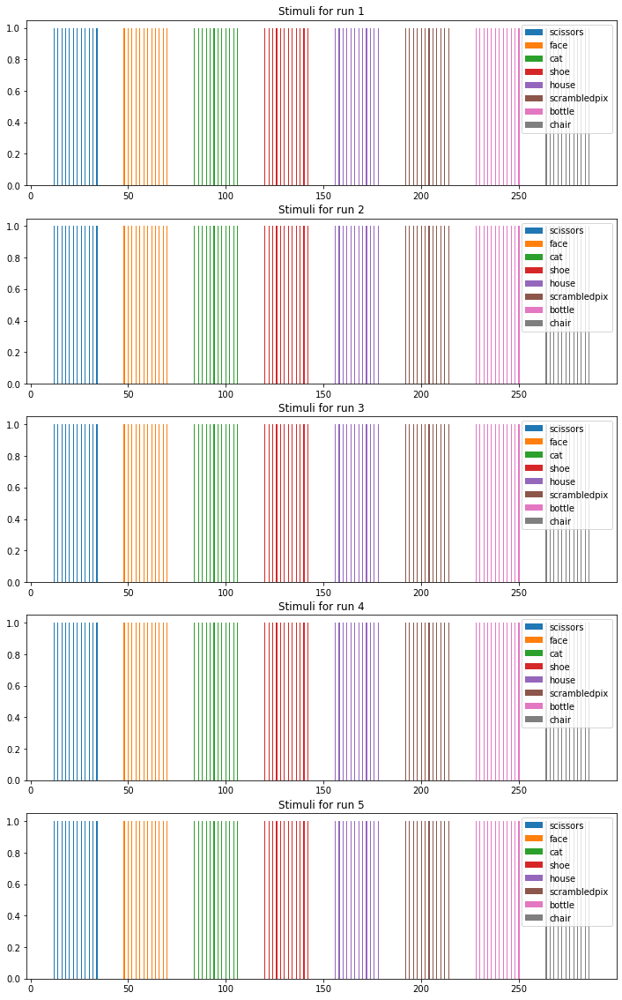

In [44]:
n_plots = len(event_files)
n_cols = 1
plt.figure(figsize=(12,4*n_plots))
for i_run, run_file in enumerate(event_files):
    events_df = run_file.get_df()
    plt.subplot(n_plots, n_cols, i_run+1)
    for trial_type in trial_types:
        plt.bar(events_df.loc[run1_events_df["trial_type"]==trial_type, "onset"], 
                1,
                events_df.loc[run1_events_df["trial_type"]==trial_type, "duration"],
                label=trial_type)
        plt.title(f"Stimuli for run {i_run+1}")
        plt.legend();

## BOLD signal and HRF

In [45]:
import nilearn

In [93]:
nilearn.__version__

'0.7.1'

In [46]:
bids_layout.get(scope="raw", subject="1", run="1", extension='nii.gz', suffix="bold")

[<BIDSImageFile filename='/home/brainhacker/glm/ds000105/sub-1/func/sub-1_task-objectviewing_run-01_bold.nii.gz'>]

In [47]:
raw_func_file = bids_layout.get(scope="raw", subject="1", run="1", extension='nii.gz', 
                                suffix="bold", return_type='filename')[0]

In [49]:
raw_func_metadata = bids_layout.get_metadata(raw_func_file)
raw_func_metadata

{'RepetitionTime': 2.5, 'TaskName': 'object viewing'}

In [50]:
tr = raw_func_metadata['RepetitionTime']
tr

2.5

In [54]:
from nilearn.glm.first_level.hemodynamic_models import glover_hrf

In [55]:
tr = 2.5

In [56]:
time_length = 32 # default from glover_hrf
hrf_tr_sampled = glover_hrf(tr=tr, oversampling=1, time_length=time_length)
tpoints_tr_sampled = np.linspace(0, time_length, len(hrf_tr_sampled), endpoint=False)
oversampling = 20
hrf_over_sampled = glover_hrf(tr=tr, oversampling=oversampling, time_length=time_length)
tpoints_over_sampled = np.linspace(0, time_length, len(hrf_over_sampled), endpoint=False)

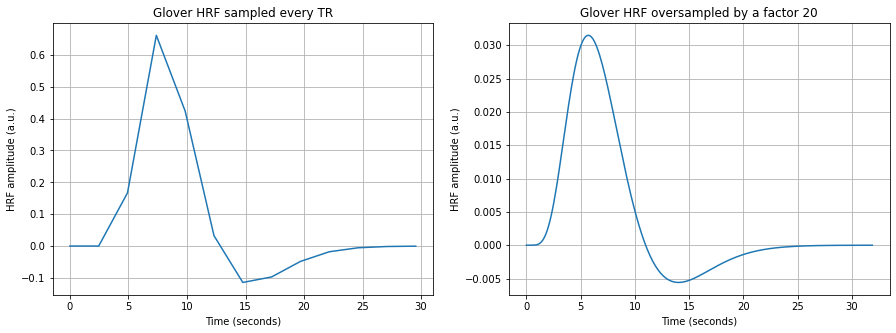

In [57]:
fig, axes = plt.subplots(ncols=2, figsize=(15,5))

axes[0].plot(tpoints_tr_sampled, hrf_tr_sampled)
axes[0].grid()
axes[0].set_ylabel('HRF amplitude (a.u.)')
axes[0].set_xlabel('Time (seconds)')
axes[0].set_title('Glover HRF sampled every TR');

axes[1].plot(tpoints_over_sampled, hrf_over_sampled)
axes[1].grid()
axes[1].set_ylabel('HRF amplitude (a.u.)')
axes[1].set_xlabel('Time (seconds)')
axes[1].set_title(f'Glover HRF oversampled by a factor {oversampling}');

### Stimuli taking into account the BOLD signal 

In [59]:
face_events_ix = (run1_events_df['trial_type'] == 'face')
run1_face_events_df = run1_events_df.loc[face_events_ix, :]

In [60]:
run1_face_events_df

,onset,duration,trial_type
12,48.0,0.5,face
13,50.0,0.5,face
14,52.0,0.5,face
15,54.0,0.5,face
16,56.0,0.5,face
17,58.0,0.5,face
18,60.0,0.5,face
19,62.0,0.5,face
20,64.0,0.5,face
21,66.0,0.5,face


#### Manually

In [61]:
stimulus_onset = 48
n_tr = func_data.shape[3]
face_stimulus = np.zeros(int(tr*n_tr))
face_stimulus[int(tr*stimulus_onset)] = 1
# Now with HRF
hrf_1s_sampled = glover_hrf(tr=tr, oversampling=tr, time_length=time_length)
face_stimulus_hrf = np.convolve(face_stimulus, hrf_1s_sampled)

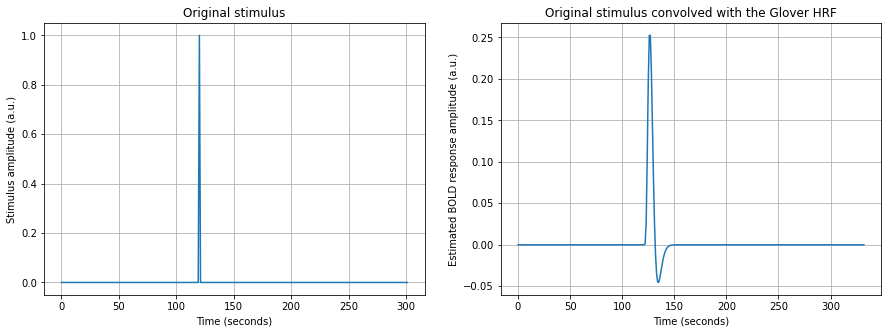

In [62]:
fig, axes = plt.subplots(ncols=2, figsize=(15,5))

axes[0].plot(face_stimulus)
axes[0].grid()
axes[0].set_ylabel('Stimulus amplitude (a.u.)')
axes[0].set_xlabel('Time (seconds)')
axes[0].set_title('Original stimulus');

axes[1].plot(face_stimulus_hrf)
axes[1].grid()
axes[1].set_ylabel('Estimated BOLD response amplitude (a.u.)')
axes[1].set_xlabel('Time (seconds)')
axes[1].set_title('Original stimulus convolved with the Glover HRF');

#### With nilearn

We need an array similar to the event dataframe we had, except it must be for a given stimulus type (e.g. face in our case), and have a stimulus `amplitude` column. In addition, the array must be transposed, i.e. instead of N stimuli x 3 columns, it must be 3 columns x N stimuli.

In [63]:
run1_face_events = run1_face_events_df[['onset', 'duration']]
run1_face_events['amplitude'] = 1
run1_face_events = run1_face_events.T

In [64]:
run1_face_events

,12,13,14,15,16,17,18,19,20,21,22,23
onset,48.0,50.0,52.0,54.0,56.0,58.0,60.0,62.0,64.0,66.0,68.0,70.0
duration,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5
amplitude,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


We also a need an array of discrete time points corresponding to each scan. Considering each scan as acquired at a time point at mid-TR, we get:

In [65]:
scan_times = np.linspace(tr/2, tr/2 + tr*n_tr, n_tr, endpoint=False)
scan_times

array([  1.25,   3.75,   6.25,   8.75,  11.25,  13.75,  16.25,  18.75,
        21.25,  23.75,  26.25,  28.75,  31.25,  33.75,  36.25,  38.75,
        41.25,  43.75,  46.25,  48.75,  51.25,  53.75,  56.25,  58.75,
        61.25,  63.75,  66.25,  68.75,  71.25,  73.75,  76.25,  78.75,
        81.25,  83.75,  86.25,  88.75,  91.25,  93.75,  96.25,  98.75,
       101.25, 103.75, 106.25, 108.75, 111.25, 113.75, 116.25, 118.75,
       121.25, 123.75, 126.25, 128.75, 131.25, 133.75, 136.25, 138.75,
       141.25, 143.75, 146.25, 148.75, 151.25, 153.75, 156.25, 158.75,
       161.25, 163.75, 166.25, 168.75, 171.25, 173.75, 176.25, 178.75,
       181.25, 183.75, 186.25, 188.75, 191.25, 193.75, 196.25, 198.75,
       201.25, 203.75, 206.25, 208.75, 211.25, 213.75, 216.25, 218.75,
       221.25, 223.75, 226.25, 228.75, 231.25, 233.75, 236.25, 238.75,
       241.25, 243.75, 246.25, 248.75, 251.25, 253.75, 256.25, 258.75,
       261.25, 263.75, 266.25, 268.75, 271.25, 273.75, 276.25, 278.75,
      

We can now generate our proper stimulus regressor (taking into account the HRF) automatically with the `compute_regressor` function.

In [66]:
from nilearn.glm.first_level.hemodynamic_models import compute_regressor

In [67]:
run1_face_events_df

,onset,duration,trial_type
12,48.0,0.5,face
13,50.0,0.5,face
14,52.0,0.5,face
15,54.0,0.5,face
16,56.0,0.5,face
17,58.0,0.5,face
18,60.0,0.5,face
19,62.0,0.5,face
20,64.0,0.5,face
21,66.0,0.5,face


In [68]:
face_reg, reg_name = compute_regressor(exp_condition=run1_face_events.values,
                                       hrf_model='glover',
                                       frame_times=scan_times)

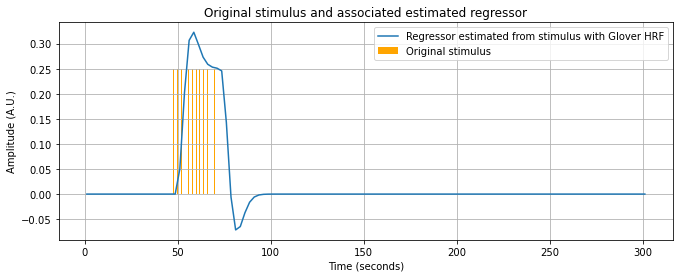

In [69]:
plt.figure(figsize=(11, 4))
plt.bar(run1_face_events_df["onset"], 0.25, run1_face_events_df["duration"], 
        color='orange', label='Original stimulus')
plt.plot(scan_times, face_reg, label='Regressor estimated from stimulus with Glover HRF')
plt.grid()
plt.ylabel('Amplitude (A.U.)')
plt.xlabel('Time (seconds)')
plt.title('Original stimulus and associated estimated regressor')
plt.legend();

#### Doing the same procedure for houses stimuli

In [70]:
# Generate required arrays to compute regressor
house_events_ix = (run1_events_df['trial_type'] == 'house')
run1_house_events_df = run1_events_df.loc[house_events_ix, :]
run1_house_events = run1_house_events_df[['onset', 'duration']]
run1_house_events['amplitude'] = 1
run1_house_events = run1_house_events.T
# Compute estimated regressor
house_reg, reg_name = compute_regressor(exp_condition=run1_house_events.values,
                                        hrf_model='glover',
                                        frame_times=scan_times)

In [71]:
run1_house_events

,48,49,50,51,52,53,54,55,56,57,58,59
onset,156.0,158.0,160.0,162.0,164.0,166.0,168.0,170.0,172.0,174.0,176.0,178.0
duration,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5
amplitude,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


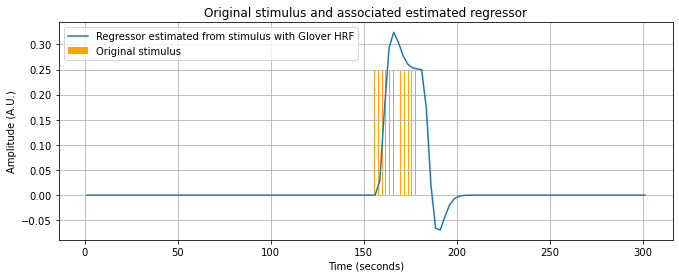

In [72]:
plt.figure(figsize=(11, 4))
plt.bar(run1_house_events_df["onset"], 0.25, run1_house_events_df["duration"], 
        color='orange', label='Original stimulus')
plt.plot(scan_times, house_reg, label='Regressor estimated from stimulus with Glover HRF')
plt.grid()
plt.ylabel('Amplitude (A.U.)')
plt.xlabel('Time (seconds)')
plt.title('Original stimulus and associated estimated regressor')
plt.legend();

### Back to the GLM

We are now close to finalizing our GLM model for that particular subject and run

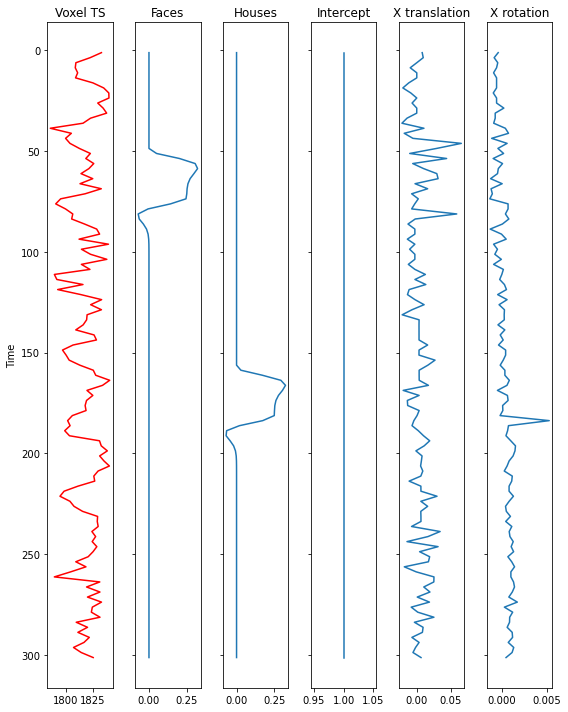

In [73]:
fig, axes = plt.subplots(ncols=6, figsize=(8, 10), sharey=True)
axes[0].plot(my_voxel_ts, scan_times, color='red')
axes[0].set_ylabel('Time')
axes[0].set_title('Voxel TS')
axes[1].plot(face_reg, scan_times)
axes[1].set_title('Faces')
axes[2].plot(house_reg, scan_times)
axes[2].set_title('Houses')
axes[3].plot(np.ones(face_reg.shape), scan_times)
axes[3].set_title('Intercept')
axes[4].plot(sub1_run1_confounds_df['trans_x'], scan_times)
axes[4].set_title('X translation')
axes[5].plot(sub1_run1_confounds_df['rot_x'], scan_times)
axes[5].set_title('X rotation')
plt.gca().invert_yaxis()
plt.tight_layout()

#### More compact visualization of regressors

In [74]:
np.ones(house_reg.shape).shape

(121, 1)

In [75]:
plt.imshow?

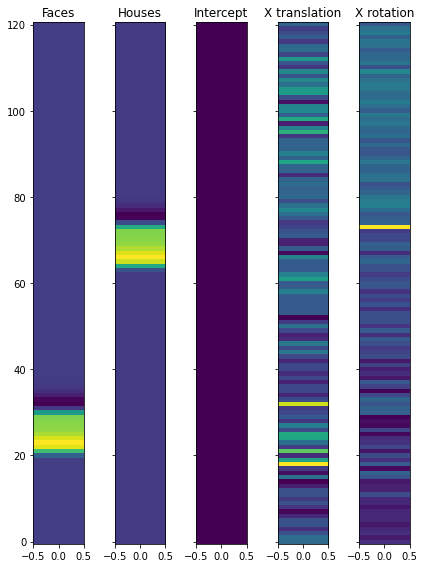

In [76]:
fig, axes = plt.subplots(ncols=5, figsize=(6, 8), sharey=True)
axes[0].imshow(face_reg, aspect='auto')
axes[0].set_title('Faces')
axes[1].imshow(house_reg, aspect='auto')
axes[1].set_title('Houses')
axes[2].imshow(np.ones(face_reg.shape), aspect='auto')
axes[2].set_title('Intercept')
axes[3].imshow(sub1_run1_confounds_df[['trans_x']], aspect='auto')
axes[3].set_title('X translation')
axes[4].imshow(sub1_run1_confounds_df[['rot_x']], aspect='auto')
axes[4].set_title('X rotation')
plt.gca().invert_yaxis()
plt.tight_layout()

#### Even more impact than a set of vectors ? Need to look at some linear algebra (slides) ...

Now that we see it makes sense to group the columns as a (design) matrix, let's implement it.

In [77]:
design_matrix_manual = np.column_stack((face_reg, house_reg, 0.25*np.ones(face_reg.shape),
                                        sub1_run1_confounds_df[['trans_x']],
                                        sub1_run1_confounds_df[['rot_x']]))

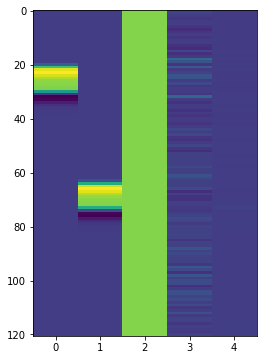

In [78]:
plt.figure(figsize=(4, 6))
plt.imshow(design_matrix_manual, aspect='auto', interpolation='none');

However nilearn offers a convenient approach to create the design matrix with `make_first_level_design_matrix`.

##### Get events of interest

In [79]:
face_house_events_ix = (run1_events_df['trial_type'] == 'face') | (run1_events_df['trial_type'] == 'house')
run1_face_house_events_df = run1_events_df.loc[face_house_events_ix, :]

In [80]:
run1_face_house_events_df

,onset,duration,trial_type
12,48.0,0.5,face
13,50.0,0.5,face
14,52.0,0.5,face
15,54.0,0.5,face
16,56.0,0.5,face
17,58.0,0.5,face
18,60.0,0.5,face
19,62.0,0.5,face
20,64.0,0.5,face
21,66.0,0.5,face


##### Get confounds of interest

In [81]:
sub1_run1_confounds_df.columns.values

array(['global_signal', 'global_signal_derivative1',
       'global_signal_derivative1_power2', 'global_signal_power2', 'csf',
       'csf_derivative1', 'csf_derivative1_power2', 'csf_power2',
       'white_matter', 'white_matter_derivative1',
       'white_matter_derivative1_power2', 'white_matter_power2', 'csf_wm',
       'tcompcor', 'std_dvars', 'dvars', 'framewise_displacement', 'rmsd',
       't_comp_cor_00', 't_comp_cor_01', 't_comp_cor_02', 'a_comp_cor_00',
       'a_comp_cor_01', 'a_comp_cor_02', 'a_comp_cor_03', 'a_comp_cor_04',
       'a_comp_cor_05', 'a_comp_cor_06', 'a_comp_cor_07', 'a_comp_cor_08',
       'a_comp_cor_09', 'a_comp_cor_10', 'a_comp_cor_11', 'a_comp_cor_12',
       'a_comp_cor_13', 'a_comp_cor_14', 'a_comp_cor_15', 'a_comp_cor_16',
       'a_comp_cor_17', 'a_comp_cor_18', 'a_comp_cor_19', 'a_comp_cor_20',
       'a_comp_cor_21', 'a_comp_cor_22', 'a_comp_cor_23', 'a_comp_cor_24',
       'a_comp_cor_25', 'a_comp_cor_26', 'a_comp_cor_27', 'a_comp_cor_28',
      

In [82]:
nuisance_regs = sub1_run1_confounds_df[['csf', 'trans_x', 'trans_y', 'trans_z', 
                                        'rot_x', 'rot_y', 'rot_z', 'motion_outlier00',
                                        'motion_outlier01', 'motion_outlier02',
                                        'motion_outlier03']]

#### Create design matrix

In [84]:
from nilearn.glm.first_level import make_first_level_design_matrix
from nilearn.plotting import plot_design_matrix

In [407]:
make_first_level_design_matrix?

In [85]:
design_matrix = make_first_level_design_matrix(frame_times=scan_times, 
                                               events=run1_face_house_events_df, 
                                               hrf_model='glover', 
                                               drift_model='cosine', 
                                               high_pass=0.01, 
                                               add_regs=nuisance_regs)

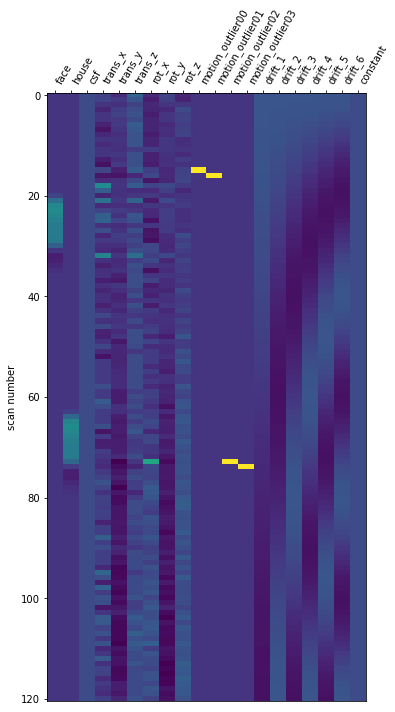

In [86]:
plot_design_matrix(design_matrix);

#### Now we can finally estimate our beta parameters and contrast

In [87]:
from nilearn.glm.first_level import FirstLevelModel

In [411]:
FirstLevelModel?

In [88]:
flm = FirstLevelModel(mask_img=func_mask_file.path,
                      smoothing_fwhm=6,
                      noise_model='ar1',
                      n_jobs=1,
                      minimize_memory=False,
                      subject_label="sub-01")

In [89]:
flm.fit(run_imgs=func_file.path, design_matrices=design_matrix)

FirstLevelModel(mask_img='/home/brainhacker/glm/ds000105/derivatives/sub-1/func/sub-1_task-objectviewing_run-1_space-MNI152NLin2009cAsym_desc-brain_mask.nii.gz',
                minimize_memory=False, signal_scaling=True, smoothing_fwhm=6,
                subject_label='sub-01')

#### Now compute the contrast

In [90]:
contrast_vec = np.zeros(design_matrix.shape[1])
contrast_vec[0] = 1
contrast_vec[1] = -1
contrast_vec

array([ 1., -1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.])

In [453]:
flm.compute_contrast?

In [91]:
face_vs_house_contrast = flm.compute_contrast(contrast_vec, stat_type='t', output_type='z_score')


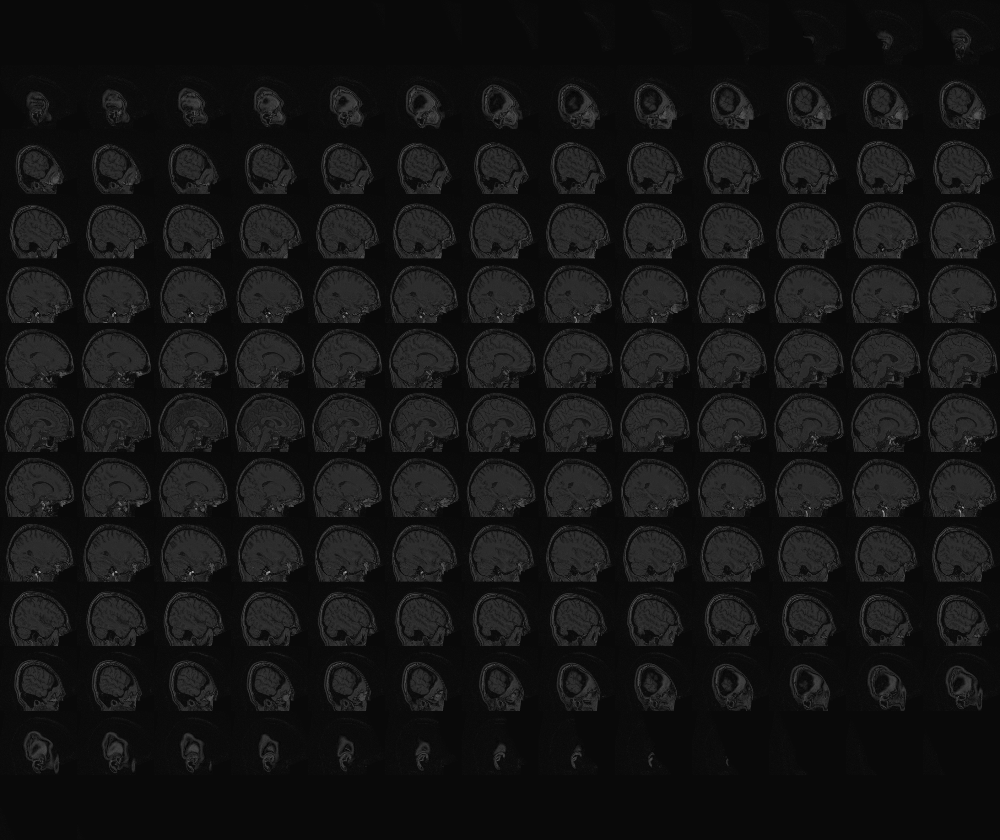
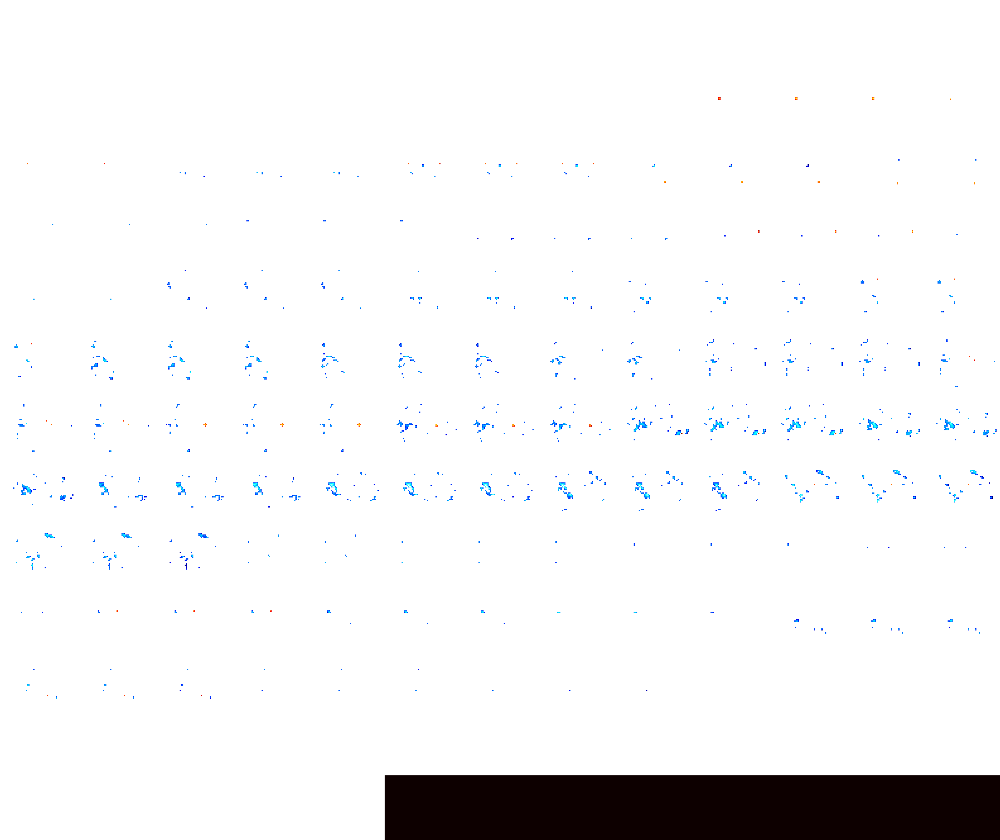

In [92]:
plotting.view_img(face_vs_house_contrast, bg_img=t1_mni_file, threshold=4, title="Face vs House contrast")

In [456]:
face_vs_house_contrast = flm.compute_contrast('face - house', stat_type='t', output_type='z_score')

#### Multiple comparison correction

In [93]:
from nilearn.glm.thresholding import threshold_stats_img

In [94]:
face_contrast_thr, thr = threshold_stats_img(face_vs_house_contrast, 
                                             mask_img=func_mask_file.path, 
                                             height_control='bonferroni', 
                                             alpha=0.05,
                                             cluster_threshold=5)

In [95]:
?threshold_stats_img


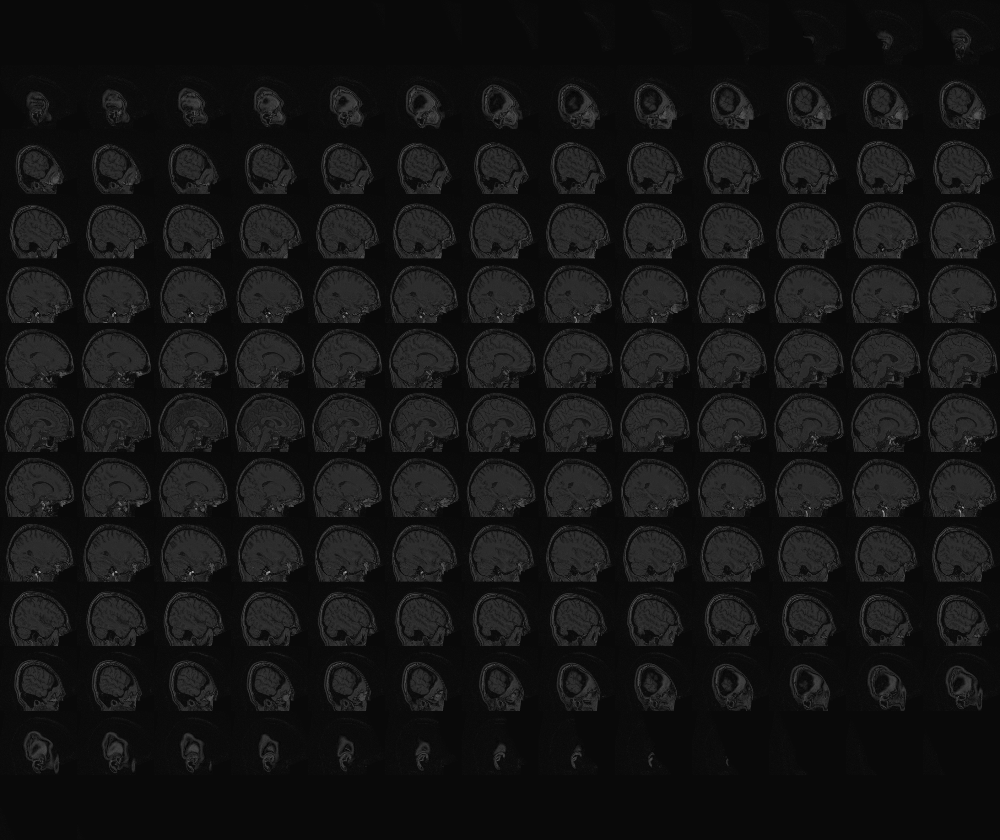
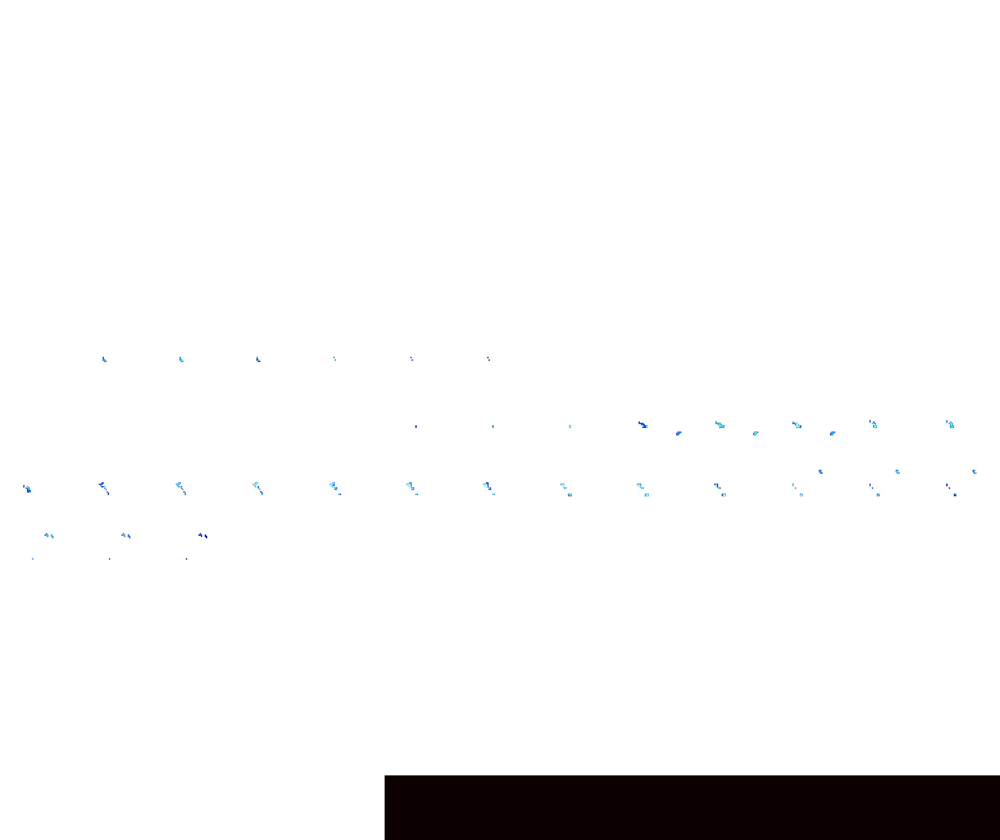

In [96]:
plotting.view_img(face_contrast_thr, bg_img=t1_mni_file, title="Face vs House contrast")

#### Generate report

In [477]:
from nilearn.reporting import make_glm_report
make_glm_report(flm, contrasts='face - house', height_control='bonferroni', 
                alpha=0.05, bg_img=t1_mni_file)

/opt/conda/shared/envs/ni38/lib/python3.8/site-packages/nilearn/plotting/html_document.py:56: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than {} '


drift_model,cosine
drift_order,1
fir_delays,[0]
high_pass (Hz),0.01
hrf_model,glover
noise_model,ar1
scaling_axis,0
signal_scaling,True
slice_time_ref,0
smoothing_fwhm,6
standardize,False


### Second level model

Let's create a list of first model objects for each subject

In [97]:
def get_flm(layout, sub_id):   
    # Get TR
    raw_func_file = layout.get(scope="raw", subject=sub_id, run="1", extension='nii.gz', 
                               suffix="bold", return_type='filename')[0]
    raw_func_metadata = layout.get_metadata(raw_func_file)
    tr = raw_func_metadata['RepetitionTime']
    # Get 4D fmri data
    func_file = layout.get(scope="derivatives", subject=sub_id, run="1", datatype='func',
                           extension='nii.gz', suffix="bold")[0]
    # Extract number of volumes and create series of scan times
    func = nib.load(func_file)
    func_data = func.get_fdata()
    n_tr = func_data.shape[3]
    scan_times = np.linspace(tr/2, tr/2 + tr*n_tr, n_tr, endpoint=False)
    # Get fmri mask
    func_mask_file = layout.get(scope="derivatives", subject=sub_id, run="1", datatype='func',
                                extension='nii.gz', suffix="mask", return_type='filename')[0]
    # Get T1 file in MNI space and its associated mask
    t1_mni_file = layout.get(subject=sub_id, scope="derivatives", datatype='anat', 
                             desc='preproc', space='MNI152NLin2009cAsym', 
                             extension='nii.gz', return_type='filename')[0]
    t1_mask_file = layout.get(subject=sub_id, scope="derivatives", datatype='anat', 
                              suffix='mask', desc='brain', extension='nii.gz', 
                              return_type='filename')[0]
    # Get event files and extract face and house
    event_files = layout.get(subject=sub_id, task="objectviewing", suffix="events")
    events_df = event_files[0].get_df()  
    face_house_events_ix = (events_df['trial_type'] == 'face') | (events_df['trial_type'] == 'house')
    face_house_events_df = events_df.loc[face_house_events_ix, :]
    # Get nuisance regressors
    confounds_file = layout.get(scope='fMRIPrep', desc='confounds', extension='tsv', 
                                subject=sub_id, run="1")[0]
    confounds_df = confounds_file.get_df()
    nuisance_cols = ['csf', 'trans_x', 'trans_y', 'trans_z', 'rot_x', 'rot_y', 'rot_z']
    nuisance_regs = confounds_df[nuisance_cols]
    # Create design matrix
    design_matrix = make_first_level_design_matrix(
        frame_times=scan_times, events=face_house_events_df, 
        hrf_model='glover', drift_model='cosine', 
        high_pass=0.01, add_regs=nuisance_regs)
    # Create first level model
    flm = FirstLevelModel(mask_img=func_mask_file, smoothing_fwhm=6,
                          noise_model='ar1', n_jobs=1,
                          minimize_memory=False, subject_label=sub_id) 
    # Fit model
    flm.fit(run_imgs=func_file.path, design_matrices=design_matrix)
    return flm

Get the collection of first level models

In [98]:
flms = []
subjects = bids_layout.get_subjects()
for sub in subjects:
    flm = get_flm(bids_layout, sub)
    flms.append(flm)

Get the contrasts for each model / subject, this time looking at effect size

In [99]:
face_vs_house_contrasts = []
for flm in flms:
    t_con = flm.compute_contrast('face - house', stat_type='t', output_type='effect_size')
    face_vs_house_contrasts.append(t_con)

Now we can construct our second-level design matrix, which will be simply to check that mean contrast is significantly greater than 0.

In [100]:
second_level_design_matrix = pd.DataFrame({'intercept': np.ones(len(subjects))})
second_level_design_matrix

,intercept
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
5,1.0


In [101]:
from nilearn.glm.second_level import SecondLevelModel

In [102]:
slm = SecondLevelModel(smoothing_fwhm=5)
slm.fit(face_vs_house_contrasts, design_matrix=second_level_design_matrix)

SecondLevelModel(smoothing_fwhm=5)

In [103]:
slm_mean_contrast = slm.compute_contrast(second_level_contrast='intercept', output_type='z_score')

In [104]:
slm_mean_contrast_thr, thr = threshold_stats_img(slm_mean_contrast,  
                                                 height_control='fpr', 
                                                 alpha=0.05,
                                                 cluster_threshold=10)

In [105]:
plotting.view_img?


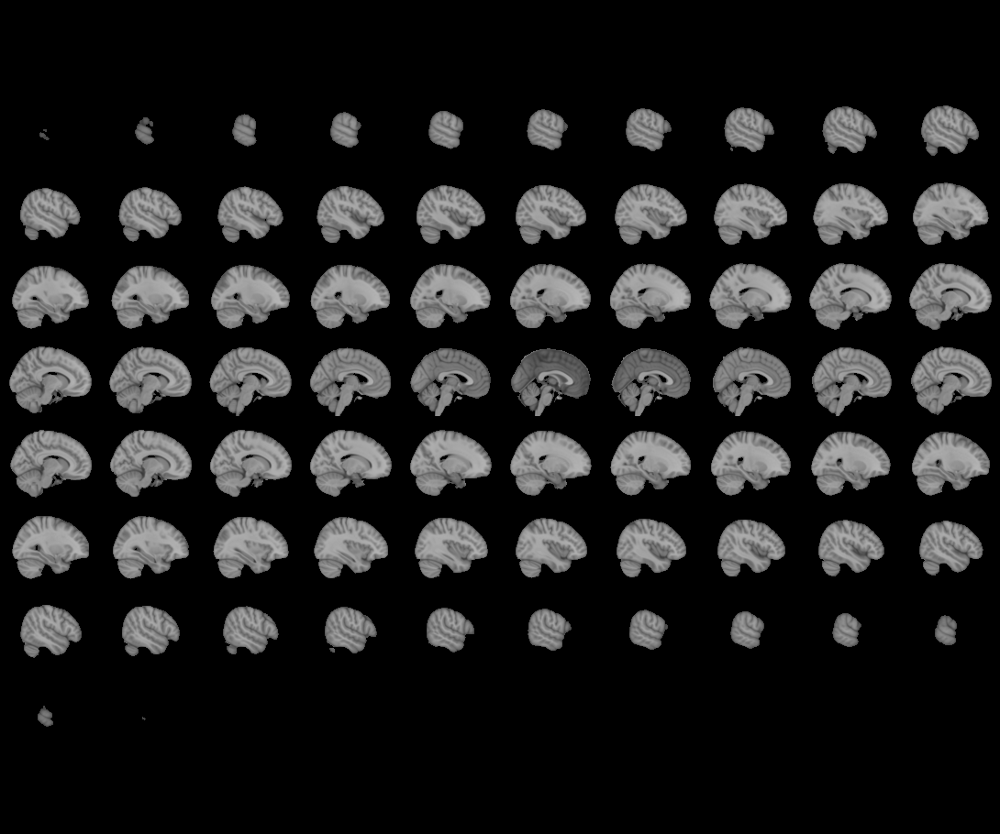
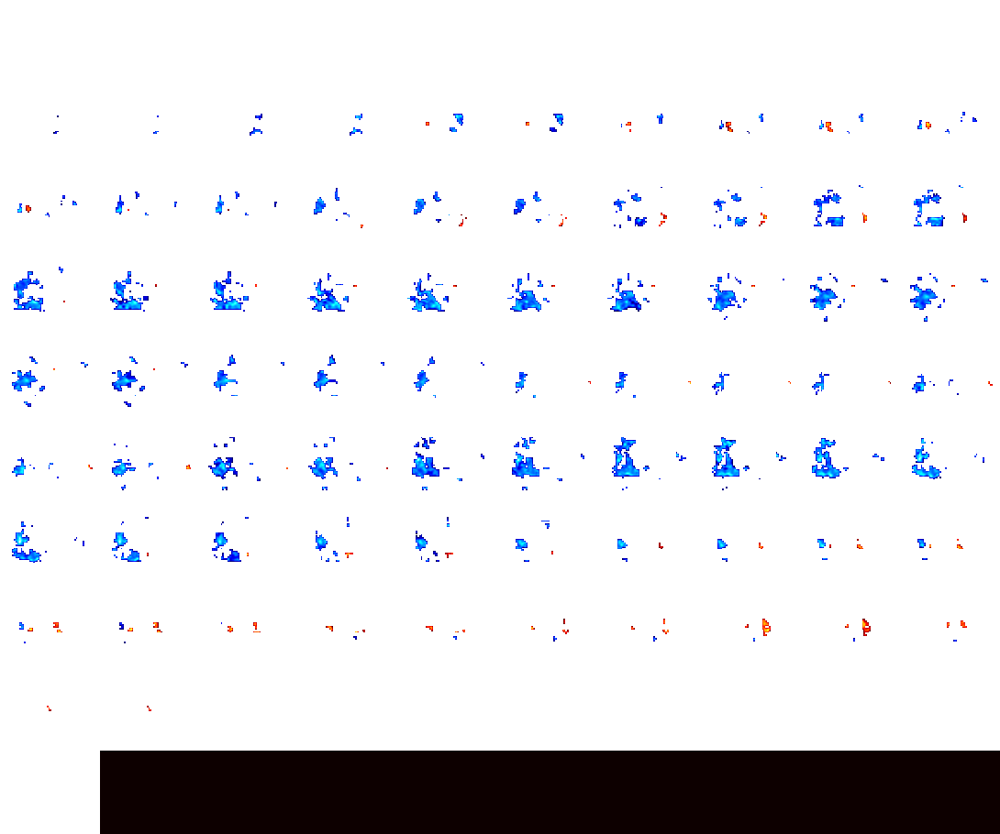

In [106]:
plotting.view_img(slm_mean_contrast_thr, title="Face vs House contrast at group level",
                  cut_coords=(10, -52, -10))

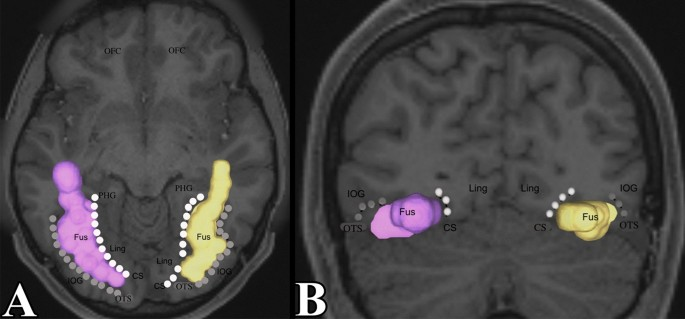

In [512]:
Image(filename="ffa.jpg", width=500)